# 📦 Install YOLOv8 and import essential libraries

In [1]:
!pip install ultralytics --quiet

from ultralytics import YOLO
from glob import glob
from PIL import Image
import matplotlib.pyplot as plt
import os
import torch

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 36.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 39.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 32.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 40.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 16.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 104.4 MB/s eta 0:00:00
Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralyt

(very important)↓
# ✅ Confirm CUDA (GPU) is available for faster training

In [2]:
torch.cuda.is_available()

True

# 📂 Unzip dataset into Colab environment

In [3]:
!unzip /content/car_license_plate.v1i.yolov8.zip -d /content/dataset/

Archive:  /content/car_license_plate.v1i.yolov8.zip
 extracting: /content/dataset/README.dataset.txt  
 extracting: /content/dataset/README.roboflow.txt  
 extracting: /content/dataset/data.yaml  
   creating: /content/dataset/test/
   creating: /content/dataset/test/images/
 extracting: /content/dataset/test/images/Cars100_png.rf.59ab65fb1cd60b07568305c878ab6b58.jpg  
 extracting: /content/dataset/test/images/Cars103_png.rf.c1396fe10252ededea5f35d8e83fb890.jpg  
 extracting: /content/dataset/test/images/Cars112_png.rf.6b7577d9914980079f0761451ffe5b40.jpg  
 extracting: /content/dataset/test/images/Cars175_png.rf.72f493b8203402b36fd1b4f352f4aad9.jpg  
 extracting: /content/dataset/test/images/Cars176_png.rf.695b57c7eed67dd6807e5c1f957e38b4.jpg  
 extracting: /content/dataset/test/images/Cars188_png.rf.e985dda16f6c6af06b65a429bd7f8624.jpg  
 extracting: /content/dataset/test/images/Cars196_png.rf.e496c2b81c46e5242a5d6320eca31412.jpg  
 extracting: /content/dataset/test/images/Cars205_pn

# 🔍 Verify that training images exist

In [36]:
val_imgs = sorted(glob('/content/dataset/valid/images/*.jpg'))
print("Found validation images:", len(val_imgs))

# Optionally print missing files (should be 0 ideally)
for img_path in val_imgs:
    if not os.path.exists(img_path):
        print(f"⚠️ Missing: {img_path}")


Found validation images: 60


# 📁 Create folders to save prediction results

In [5]:
before_dir = '/content/inference_results/before_training'
after_dir = '/content/inference_results/after_training'
os.makedirs(before_dir, exist_ok=True)
os.makedirs(after_dir, exist_ok=True)

# 📦 Load YOLOv8s model (pre-trained on COCO)

In [37]:
model = YOLO('yolov8m.pt')

# 🔍 Run inference BEFORE training for comparison

In [38]:
print("📸 Predicting before training...")
model.predict(
    source=val_imgs,
    save=True,
    save_txt=False,
    device=0,
    project=before_dir,
    name='preds'
)
print("✅ Saved predictions before training.")

📸 Predicting before training...

0: 640x640 1 car, 1 truck, 21.5ms
1: 640x640 1 car, 21.5ms
2: 640x640 1 car, 21.5ms
3: 640x640 1 truck, 21.5ms
4: 640x640 1 car, 1 truck, 21.5ms
5: 640x640 17 cars, 21.5ms
6: 640x640 3 cars, 21.5ms
7: 640x640 12 cars, 21.5ms
8: 640x640 15 persons, 4 cars, 21.5ms
9: 640x640 1 car, 21.5ms
10: 640x640 1 car, 21.5ms
11: 640x640 3 cars, 2 traffic lights, 21.5ms
12: 640x640 4 cars, 21.5ms
13: 640x640 1 car, 21.5ms
14: 640x640 3 cars, 1 truck, 21.5ms
15: 640x640 3 cars, 1 truck, 2 traffic lights, 21.5ms
16: 640x640 1 car, 21.5ms
17: 640x640 1 car, 21.5ms
18: 640x640 1 car, 21.5ms
19: 640x640 2 cars, 1 truck, 21.5ms
20: 640x640 1 person, 14 cars, 2 trucks, 5 traffic lights, 21.5ms
21: 640x640 2 cars, 21.5ms
22: 640x640 8 cars, 1 truck, 21.5ms
23: 640x640 1 car, 21.5ms
24: 640x640 1 car, 21.5ms
25: 640x640 1 car, 21.5ms
26: 640x640 1 car, 1 train, 21.5ms
27: 640x640 1 person, 8 cars, 1 truck, 21.5ms
28: 640x640 1 clock, 21.5ms
29: 640x640 1 car, 21.5ms
30: 640x6

# Training model on our dataset


In [9]:
# Train model
print("🚀 Training model...")
model.train(
    data='/content/data.yaml',
    epochs=100,
    imgsz=640,
    batch=16,
    device=0,
    patience=30,
    pretrained=True,
    name='car-plate-detector_by_HammadAshrafDev'
)

🚀 Training model...
Ultralytics 8.3.162 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=car-plate-detector_by_HammadAshrafDev2, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=30, perspectiv

100%|██████████| 755k/755k [00:00<00:00, 22.5MB/s]

Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
  1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
  2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
  3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  4                  -1  4    813312  ultralytics.nn.modules.block.C2f             [192, 192, 4, True]           
  5                  -1  1    664320  ultralytics.nn.modules.conv.Conv             [192, 384, 3, 2]              
  6                  -1  4   3248640  ultralytics.nn.modules.block.C2f             [384, 384, 4, True]           
  7                  -1  1   1991808  ultralytics

 18                  -1  2   1846272  ultralytics.nn.modules.block.C2f             [576, 384, 2]                 
 19                  -1  1   1327872  ultralytics.nn.modules.conv.Conv             [384, 384, 3, 2]              
 20             [-1, 9]  1         0  ultralytics.nn.modules.conv.Concat           [1]                           
 21                  -1  2   4207104  ultralytics.nn.modules.block.C2f             [960, 576, 2]                 
 22        [15, 18, 21]  1   3776275  ultralytics.nn.modules.head.Detect           [1, [192, 384, 576]]          
Model summary: 169 layers, 25,856,899 parameters, 25,856,883 gradients, 79.1 GFLOPs

Transferred 84/475 items from pretrained weights
Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...


100%|██████████| 5.35M/5.35M [00:00<00:00, 87.7MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.0±0.0 ms, read: 949.2±349.7 MB/s, size: 22.2 KB)


train: Scanning /content/dataset/train/labels... 210 images, 0 backgrounds, 0 corrupt: 100%|██████████| 210/210 [00:00<00:00, 1891.89it/s]

train: New cache created: /content/dataset/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 404.0±259.0 MB/s, size: 20.3 KB)


val: Scanning /content/dataset/valid/labels... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<00:00, 1705.35it/s]

val: New cache created: /content/dataset/valid/labels.cache


Plotting labels to runs/detect/car-plate-detector_by_HammadAshrafDev2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/car-plate-detector_by_HammadAshrafDev2
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      5.99G      3.002      4.179      2.305          4        640: 100%|██████████| 14/14 [00:08<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.22it/s]

                   all         60         64      0.217      0.234     0.0883     0.0291



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      6.06G      1.748      2.255      1.425          3        640: 100%|██████████| 14/14 [00:07<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.39it/s]

                   all         60         64      0.502      0.409       0.37      0.195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      6.16G      1.736      1.887      1.359          4        640: 100%|██████████| 14/14 [00:06<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.66it/s]

                   all         60         64      0.503      0.474      0.479      0.234



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100       6.4G      1.555      1.761      1.282          8        640: 100%|██████████| 14/14 [00:06<00:00,  2.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.55it/s]

                   all         60         64      0.714      0.656      0.695      0.369



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      6.56G      1.482      1.442      1.304          2        640: 100%|██████████| 14/14 [00:06<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.53it/s]

                   all         60         64       0.89      0.609      0.727      0.353



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      6.71G      1.584      1.474      1.274          5        640: 100%|██████████| 14/14 [00:07<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.14it/s]

                   all         60         64      0.651      0.553      0.611      0.305



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      6.85G      1.506      1.336      1.263          6        640: 100%|██████████| 14/14 [00:06<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.47it/s]

                   all         60         64       0.97      0.672      0.834      0.487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      6.99G      1.507      1.261      1.277          9        640: 100%|██████████| 14/14 [00:07<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.65it/s]

                   all         60         64      0.537      0.616        0.6      0.341



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      7.15G        1.4      1.224      1.184          3        640: 100%|██████████| 14/14 [00:07<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.12it/s]

                   all         60         64      0.587      0.641      0.581      0.289



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      7.29G      1.367      1.061      1.212          3        640: 100%|██████████| 14/14 [00:07<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.75it/s]

                   all         60         64      0.695      0.711       0.73      0.416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      7.42G       1.38      1.018      1.219          2        640: 100%|██████████| 14/14 [00:07<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.76it/s]

                   all         60         64      0.812      0.809      0.833      0.441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      6.56G      1.385     0.9533      1.216          4        640: 100%|██████████| 14/14 [00:07<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.59it/s]

                   all         60         64      0.901      0.766       0.86      0.472



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      6.56G      1.398     0.9894      1.268          4        640: 100%|██████████| 14/14 [00:06<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.69it/s]

                   all         60         64       0.91      0.788      0.883      0.464



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      6.56G      1.357     0.8896      1.197          7        640: 100%|██████████| 14/14 [00:07<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.74it/s]

                   all         60         64      0.825      0.812      0.778       0.42



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      6.61G      1.336     0.9205      1.207          5        640: 100%|██████████| 14/14 [00:07<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.17it/s]

                   all         60         64      0.859      0.766      0.791      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      6.71G      1.374     0.9022      1.198          7        640: 100%|██████████| 14/14 [00:06<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.65it/s]

                   all         60         64       0.82      0.672       0.74      0.389



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      6.88G      1.347      1.002      1.152          1        640: 100%|██████████| 14/14 [00:06<00:00,  2.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.63it/s]

                   all         60         64      0.795       0.75      0.771      0.403



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      7.01G      1.311     0.8363      1.213          3        640: 100%|██████████| 14/14 [00:07<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.11it/s]

                   all         60         64      0.758      0.766      0.757      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      7.14G      1.362     0.8703      1.174          8        640: 100%|██████████| 14/14 [00:06<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.69it/s]

                   all         60         64      0.864      0.688      0.819      0.435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      7.31G      1.238     0.8048      1.168          5        640: 100%|██████████| 14/14 [00:06<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.93it/s]

                   all         60         64      0.765      0.734      0.772      0.391



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      7.44G      1.315     0.8536       1.18          2        640: 100%|██████████| 14/14 [00:07<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.58it/s]

                   all         60         64      0.732      0.766      0.767      0.381



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      6.51G       1.24     0.8422       1.12          3        640: 100%|██████████| 14/14 [00:06<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.61it/s]

                   all         60         64      0.787      0.688      0.761      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      6.51G      1.267     0.8933      1.146          2        640: 100%|██████████| 14/14 [00:06<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.65it/s]

                   all         60         64      0.682      0.704      0.691      0.382



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      6.94G      1.311     0.8373      1.152          5        640: 100%|██████████| 14/14 [00:07<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.20it/s]

                   all         60         64      0.842      0.766      0.828      0.449



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      7.01G      1.267     0.8517       1.16          3        640: 100%|██████████| 14/14 [00:06<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.65it/s]

                   all         60         64      0.843       0.75      0.845      0.446



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      7.07G      1.247     0.7887      1.153          4        640: 100%|██████████| 14/14 [00:07<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.75it/s]

                   all         60         64      0.821      0.812      0.837      0.473



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      7.14G      1.257     0.7415      1.144          3        640: 100%|██████████| 14/14 [00:07<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.03it/s]

                   all         60         64      0.827      0.797      0.857      0.445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      7.21G      1.212     0.7803      1.168          6        640: 100%|██████████| 14/14 [00:06<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.76it/s]

                   all         60         64      0.786      0.766      0.827       0.45



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      7.27G      1.179     0.7322      1.109          7        640: 100%|██████████| 14/14 [00:06<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.60it/s]

                   all         60         64      0.744      0.817      0.797       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      7.34G      1.158     0.7039      1.149          3        640: 100%|██████████| 14/14 [00:06<00:00,  2.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.02it/s]

                   all         60         64      0.794      0.781      0.824       0.48



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      7.41G        1.1     0.6997      1.087          4        640: 100%|██████████| 14/14 [00:06<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.81it/s]

                   all         60         64       0.82      0.766      0.836       0.48



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      6.52G      1.131     0.7041      1.089          2        640: 100%|██████████| 14/14 [00:07<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.65it/s]

                   all         60         64      0.859      0.764      0.853      0.459



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      6.52G      1.112     0.6618       1.09          4        640: 100%|██████████| 14/14 [00:06<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.27it/s]

                   all         60         64      0.858      0.688      0.796      0.446



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      6.96G      1.163     0.6778      1.093          6        640: 100%|██████████| 14/14 [00:06<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.79it/s]

                   all         60         64      0.832      0.772      0.852      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      7.03G      1.164     0.6993      1.082          4        640: 100%|██████████| 14/14 [00:06<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.63it/s]

                   all         60         64      0.778      0.844      0.831      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100       7.1G      1.121     0.6776      1.087          8        640: 100%|██████████| 14/14 [00:07<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.14it/s]

                   all         60         64      0.891      0.734      0.842      0.457



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      7.16G      1.103     0.6259      1.062          4        640: 100%|██████████| 14/14 [00:06<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.58it/s]

                   all         60         64       0.84      0.734      0.827      0.443
EarlyStopping: Training stopped early as no improvement observed in last 30 epochs. Best results observed at epoch 7, best model saved as best.pt.
To update EarlyStopping(patience=30) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



37 epochs completed in 0.091 hours.
Optimizer stripped from runs/detect/car-plate-detector_by_HammadAshrafDev2/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/car-plate-detector_by_HammadAshrafDev2/weights/best.pt, 52.0MB

Validating runs/detect/car-plate-detector_by_HammadAshrafDev2/weights/best.pt...
Ultralytics 8.3.162 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 92 layers, 25,840,339 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.52it/s]


                   all         60         64      0.969      0.672      0.834      0.487
Speed: 0.2ms preprocess, 10.0ms inference, 0.0ms loss, 4.4ms postprocess per image
Results saved to runs/detect/car-plate-detector_by_HammadAshrafDev2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7a62e681bf50>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

# Load best model after training

In [39]:
trained_model_path = 'runs/detect/car-plate-detector_by_HammadAshrafDev2/weights/best.pt'
trained_model = YOLO(trained_model_path)

# Run inference AFTER training

In [40]:
print("-----Running inference after training...")
results_after = trained_model.predict(source=val_imgs, save=True, save_txt=False, device=0, project=after_dir, name='preds')
print("✅ Saved AFTER training predictions.")

-----Running inference after training...

0: 640x640 1 licence, 20.9ms
1: 640x640 1 licence, 20.9ms
2: 640x640 1 licence, 20.9ms
3: 640x640 2 licences, 20.9ms
4: 640x640 1 licence, 20.9ms
5: 640x640 1 licence, 20.9ms
6: 640x640 1 licence, 20.9ms
7: 640x640 (no detections), 20.9ms
8: 640x640 1 licence, 20.9ms
9: 640x640 2 licences, 20.9ms
10: 640x640 1 licence, 20.9ms
11: 640x640 1 licence, 20.9ms
12: 640x640 1 licence, 20.9ms
13: 640x640 1 licence, 20.9ms
14: 640x640 1 licence, 20.9ms
15: 640x640 2 licences, 20.9ms
16: 640x640 1 licence, 20.9ms
17: 640x640 1 licence, 20.9ms
18: 640x640 1 licence, 20.9ms
19: 640x640 1 licence, 20.9ms
20: 640x640 (no detections), 20.9ms
21: 640x640 4 licences, 20.9ms
22: 640x640 1 licence, 20.9ms
23: 640x640 1 licence, 20.9ms
24: 640x640 1 licence, 20.9ms
25: 640x640 1 licence, 20.9ms
26: 640x640 1 licence, 20.9ms
27: 640x640 1 licence, 20.9ms
28: 640x640 2 licences, 20.9ms
29: 640x640 1 licence, 20.9ms
30: 640x640 1 licence, 20.9ms
31: 640x640 1 licence

# **Evaluating on validation set**

In [ ]:
metrics = model.val()
print("Validation Results:", metrics)

# **To Run inference on multiple test images**

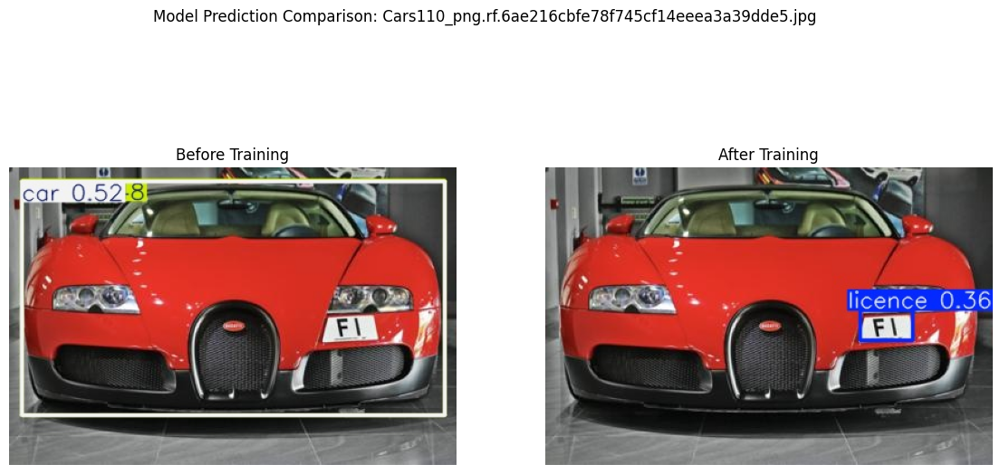

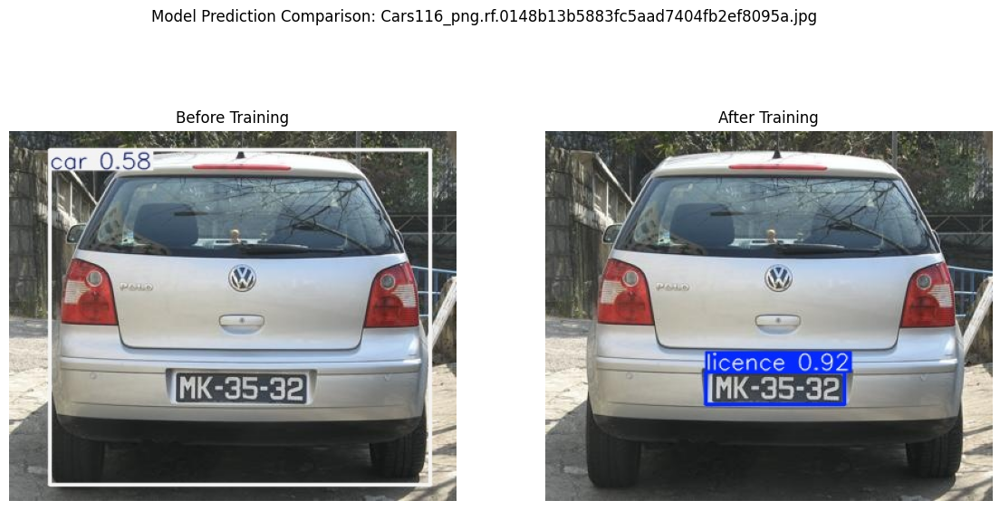

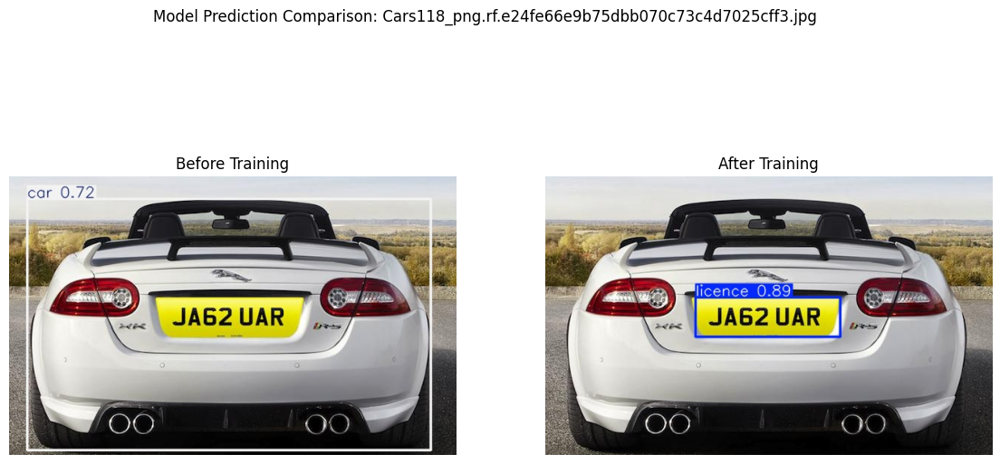

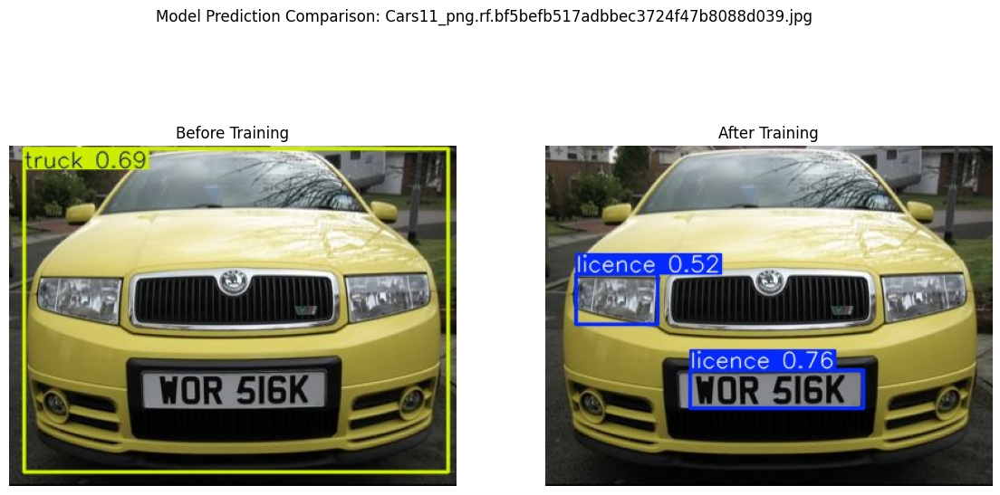

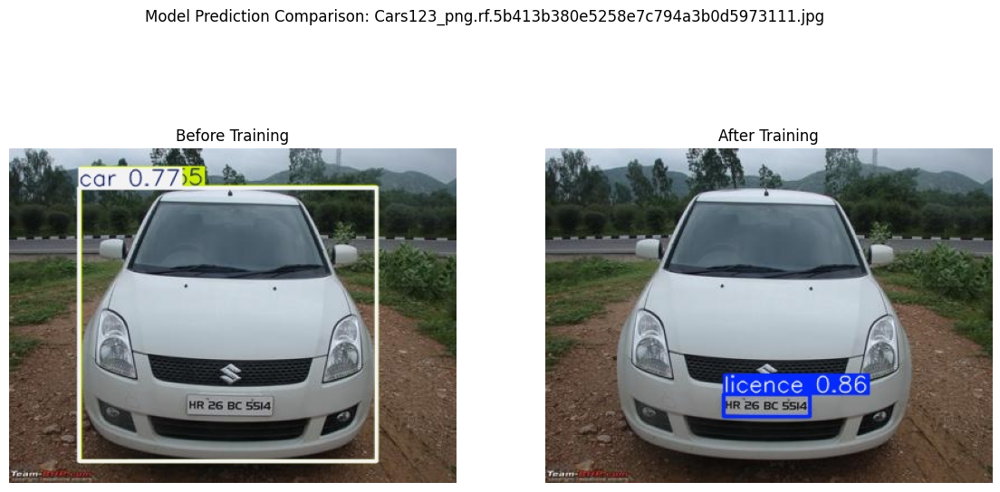

...

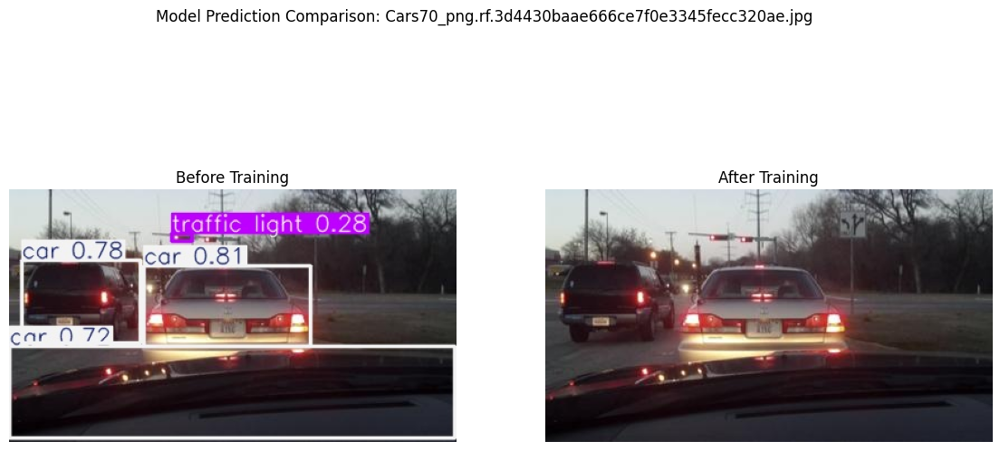

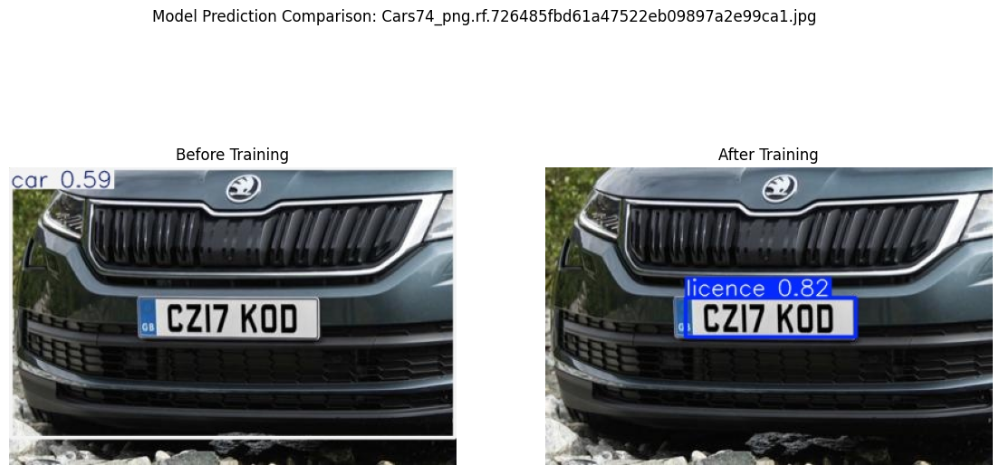

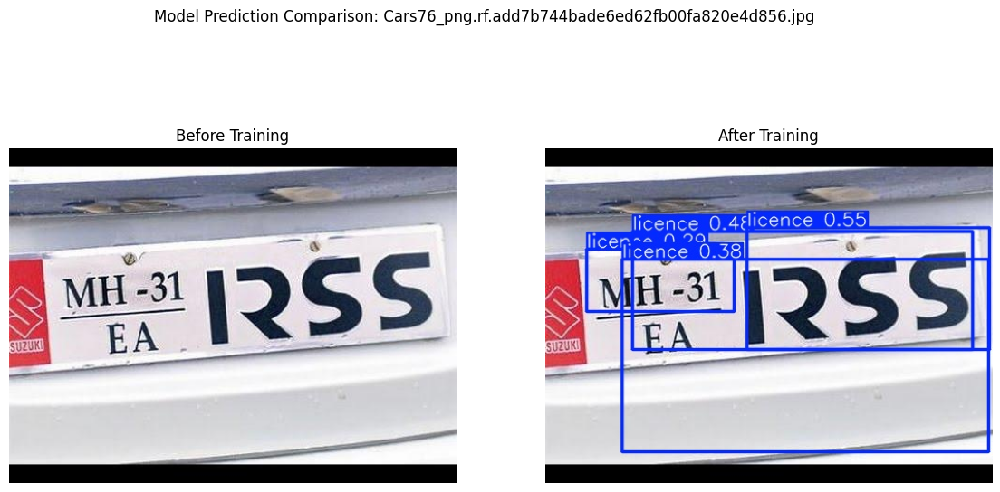

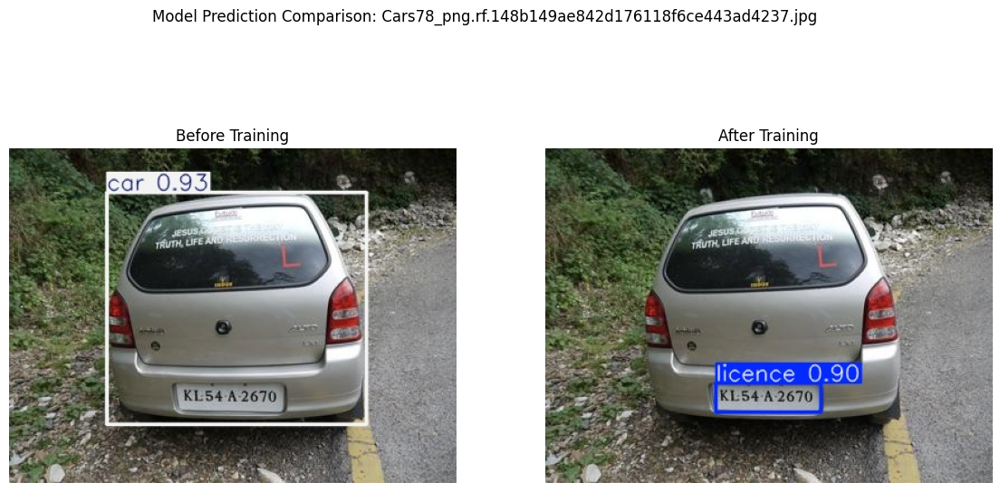

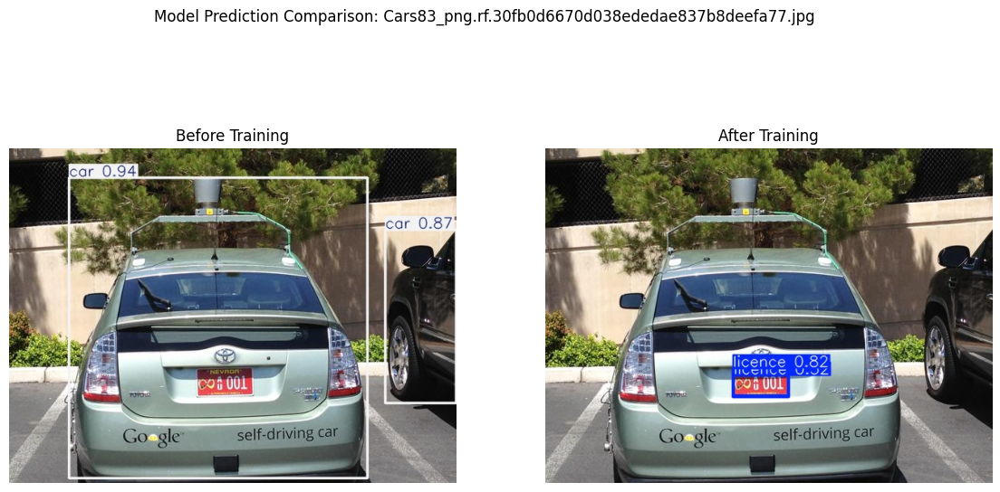

In [43]:
# Displaying sample predictions (before vs after)
for i in range(len(val_imgs)):
    before_img = f"{before_dir}/preds6/{os.path.basename(val_imgs[i])}"
    after_img = f"{after_dir}/preds6/{os.path.basename(val_imgs[i])}"

    if os.path.exists(before_img) and os.path.exists(after_img):
        img1 = Image.open(before_img)
        img2 = Image.open(after_img)

        fig, axs = plt.subplots(1, 2, figsize=(14, 7))
        axs[0].imshow(img1)
        axs[0].set_title("Before Training")
        axs[0].axis('off')

        axs[1].imshow(img2)
        axs[1].set_title("After Training")
        axs[1].axis('off')

        plt.suptitle(f"Model Prediction Comparison: {os.path.basename(val_imgs[i])}")
        plt.show()


# **Exporting trained model to multiple formats**

In [16]:
best_model_path = model.ckpt_path if hasattr(model, 'ckpt_path') else f'runs/detect/car-plate-detector_by_HammadAshrafDev/weights/best.pt'
trained_model = YOLO(best_model_path)

trained_model.export(format='onnx')
trained_model.export(format='torchscript')
trained_model.export(format='tflite')

Ultralytics 8.3.162 🚀 Python-3.11.13 torch-2.6.0+cu124 CPU (Intel Xeon 2.00GHz)
💡 ProTip: Export to OpenVINO format for best performance on Intel hardware. Learn more at https://docs.ultralytics.com/integrations/openvino/
YOLOv8m summary (fused): 92 layers, 25,886,080 parameters, 0 gradients, 78.9 GFLOPs

PyTorch: starting from 'yolov8m.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 84, 8400) (49.7 MB)
requirements: Ultralytics requirements ['onnx>=1.12.0,<1.18.0', 'onnxslim>=0.1.56', 'onnxruntime-gpu'] not found, attempting AutoUpdate...

requirements: AutoUpdate success ✅ 5.1s
WARNING ⚠️ requirements: Restart runtime or rerun command for updates to take effect


ONNX: starting export with onnx 1.17.0 opset 19...
ONNX: slimming with onnxslim 0.1.58...
ONNX: export success ✅ 10.0s, saved as 'yolov8m.onnx' (99.0 MB)

Export complete (12.3s)
Results saved to /content
Predict:         yolo predict task=detect model=yolov8m.onnx imgsz=640  
Validate:        yolo val tas

100%|██████████| 1.11M/1.11M [00:00<00:00, 25.0MB/s]
Unzipping calibration_image_sample_data_20x128x128x3_float32.npy.zip to /content/calibration_image_sample_data_20x128x128x3_float32.npy...: 100%|██████████| 1/1 [00:00<00:00, 45.47file/s]


ONNX: starting export with onnx 1.17.0 opset 19...


ONNX: slimming with onnxslim 0.1.58...
ONNX: export success ✅ 7.4s, saved as 'yolov8m.onnx' (99.1 MB)
TensorFlow SavedModel: starting TFLite export with onnx2tf 1.28.0...
Saved artifact at 'yolov8m_saved_model'. The following endpoints are available:

* Endpoint 'serving_default'
  inputs_0 (POSITIONAL_ONLY): TensorSpec(shape=(1, 640, 640, 3), dtype=tf.float32, name='images')
Output Type:
  TensorSpec(shape=(1, 84, 8400), dtype=tf.float32, name=None)
Captures:
  134567140422480: TensorSpec(shape=(4, 2), dtype=tf.int32, name=None)
  134567140422864: TensorSpec(shape=(3, 3, 3, 48), dtype=tf.float32, name=None)
  134567140423248: TensorSpec(shape=(48,), dtype=tf.float32, name=None)
  134567129220496: TensorSpec(shape=(4, 2), dtype=tf.int32, name=None)
  134567140424784: TensorSpec(shape=(3, 3, 48, 96), dtype=tf.float32, name=None)
  134567129221456: TensorSpec(shape=(96,), dtype=tf.float32, name=None)
  134567140423056: TensorSpec(shape=(1, 1, 96, 96), dtype=tf.float32, name=None)
  13456

'yolov8m_saved_model/yolov8m_float32.tflite'

# **Automatically download the exported models**
(Run this cell as well and leave colab running)

In [ ]:

from google.colab import files

export_formats = ['onnx', 'torchscript', 'tflite']
for fmt in export_formats:
    file_path = f'runs/detect/car-plate-detector_by_HammadAshrafDev/weights/best.{fmt}'
    if os.path.exists(file_path):
        files.download(file_path)